<a href="https://colab.research.google.com/github/rachanrv/STOCK-ANALYSIS-ZOMBIE-STOCK-TEST-AND-PORTFOLIO-MANAGEMENT/blob/master/MSFT_Code.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# INTRODUCTION

Enter text here

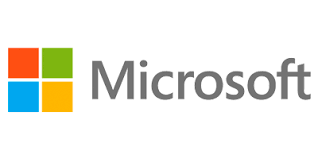

## Loading the Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Please copy the path for pre.csv(ARIMA Predictions) without ' 'on your drive here and Press Enter

In [ ]:
p=input("Enter the path for pre.csv on your drive here=" )

Enter the path for pre.csv on your drive here=


# DATA GATHERING AND DESCRIPTION 

PACKAGES:
* We import standard libraries like pandas and numpy.
* We also imported the libraries that can scrape from yahoo-database(fix_yahoo_finance & yfinance).
* Furthur we added a dataframe wrapper (pandas_datareader) to download neat dataframes.
* Then,we imported matplotlib and seaborn for plots.
* We also imported warnings library & % matplotlib inline to suppress errors.
* Finally,we imported datetime to deal with dates easily.



STEPS:
1. We downloaded MSFT stocks(prices and dividends) data from 2009-01-01 as MSFT had a drastic change in stock price after that year.
2. There were no missing values in the data but the dates were not continuous.Timeseries can bw applied on periodic and continous data.
3. Therefore,we imputed the data into another dataframe with continous dates and did a forward fill and backfill for imputation.
4. We observed the correlation of the data and we observed that there was high correlation between the variables and the target was easily modelled with every variables(prices).
5. Hence, we found technical analysis with  library called 'ta' which can enhance our variables and give us more volatility factors and we added them to our predictors.
6. We filled the NAs with 0 as the variables used differences of prices assuming the stock price didn't change the days before 2009.
7. For  Exploratory Data Analysis,We found the range of the data by boxplots to find outliers that we didn't want to exclude because it was reasonable that the stock price could increase rapidly any day.
8. Then, we did candle stick plots from plotly.graph_objects library to see the days the MSFT Stock could be bought.
9. Finally,we imported pandas-profiler to get a report on our dataset on Exploratory Data Analysis. 

## Loading Libraries

In [ ]:
!pip install fix_yahoo_finance 

In [ ]:
import numpy as np
import pandas as pd
pd.core.common.is_list_like = pd.api.types.is_list_like
import matplotlib.pyplot as plt
import pandas_datareader as pdr
import datetime 
from sklearn.preprocessing import MinMaxScaler
import seaborn as sns
import warnings
% matplotlib inline

In [ ]:
import fix_yahoo_finance as fyf
from pandas_datareader import data as pdr
fyf.pdr_override()

In [ ]:
%pip install yfinance
import yfinance as yf

In [ ]:
%pip install ta
import ta
import datetime 

In [ ]:
msft = yf.Ticker("MSFT")

In [ ]:
#msft.get_info() #to know about company history and revenue and statistics

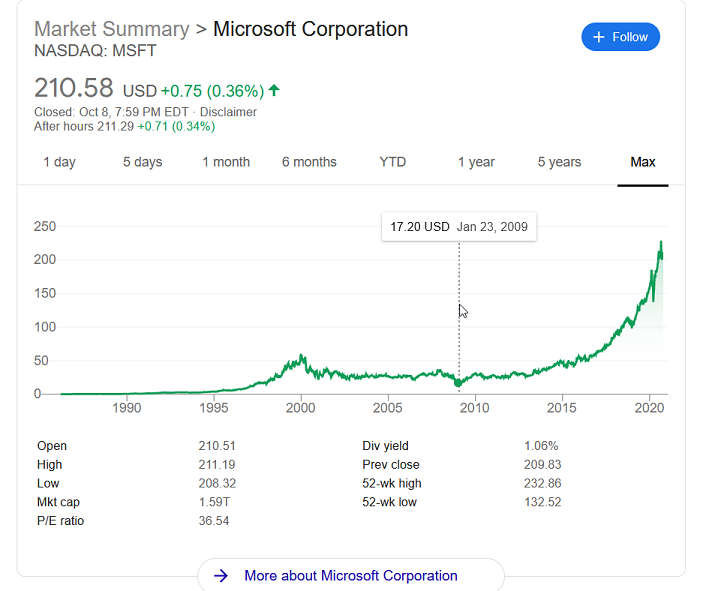

In [ ]:
data = pdr.get_data_yahoo('MSFT',start='2009-01-01') #MSFT stock price has a drastic rise after 2009 
split = msft.history(start='2009-01-01')

data['Dividends']=split['Dividends']

[*********************100%***********************]  1 of 1 downloaded


In [ ]:
data.columns=['Open', 'High', 'Low', 'Close', 'AdjClose', 'Volume','Dividends'] 
            

In [ ]:
data

,Open,High,Low,Close,AdjClose,Volume,Dividends
Date,,,,,,,
2009-01-02,19.530001,20.400000,19.370001,20.330000,15.511667,50084000,0.0
2009-01-05,20.200001,20.670000,20.059999,20.520000,15.656638,61475200,0.0
2009-01-06,20.750000,21.000000,20.610001,20.760000,15.839754,58083400,0.0
2009-01-07,20.190001,20.290001,19.480000,19.510000,14.886011,72709900,0.0
2009-01-08,19.629999,20.190001,19.549999,20.120001,15.351432,70255400,0.0
...,...,...,...,...,...,...,...
2020-10-05,207.220001,210.410004,206.979996,210.380005,210.380005,21331600,0.0
2020-10-06,208.820007,210.179993,204.820007,205.910004,205.910004,28554300,0.0
2020-10-07,207.059998,210.110001,206.720001,209.830002,209.830002,25681100,0.0


In [ ]:
data.info() #0missingvalues 

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2964 entries, 2009-01-02 to 2020-10-09
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Open       2964 non-null   float64
 1   High       2964 non-null   float64
 2   Low        2964 non-null   float64
 3   Close      2964 non-null   float64
 4   AdjClose   2964 non-null   float64
 5   Volume     2964 non-null   int64  
 6   Dividends  2964 non-null   float64
dtypes: float64(6), int64(1)
memory usage: 185.2 KB


## Imputation

In [ ]:
dt = datetime.date(2009, 1, 1)
end = datetime.date.today()-datetime.timedelta(days=2)
day=pd.date_range(start=dt,end=end,freq='D')
col=data.columns
temp=pd.DataFrame([],index=day,columns=col)
dat=temp.index
date=data.index
for i in date:
  for x in dat:
    if x==i:
      temp.loc[x,:]=data.loc[i,:]
    
#Imputation
#temp=temp.interpolate(method="linear") #Another Method

In [ ]:
temp=temp.ffill()
temp=temp.bfill()

In [ ]:
data=temp

## Feature Enhancement(Technical Analysis for Volatitilty Parameters)

In [ ]:
def calc_vol(df, n=21):
    """
    calculate rolling window volatility
    (STD), and add related columns. Default is 21 day.
    """
    df['Return'] = np.log(df.Close).diff()
    df['Volatility'] = df['Return'].rolling(n).std()
    df['Change'] = df['Close'].diff()
    df['Exp_Change'] = (df['Volatility'] * df['Close']).shift(1)
    df['Magnitude'] = df['Change'] / df['Exp_Change']
    df['Abs_Magnitude'] = np.abs(df.Magnitude)

# calculate intraday volatility
def high_low(df):
    df['High_Low_Spread'] = (df['High'] - df['Low']) / df['Close']

# return dataframe containing data for expiration Fridays
def exp_friday(df):
    mask = np.where((df.index.day > 14) & 
                    (df.index.day < 22) & 
                    (df.index.dayofweek == 4), True, False)
    return df[mask]

# return a data frame containing data with large upward moves
def low_vol_duration(df):
    pd.set_option('mode.chained_assignment', None)
    df['Days<2sd'] = 0
    count = 0
    for row in range(len(df)):

        if df['Magnitude'].iloc[row] < 2:
            count += 1
            df['Days<2sd'].iloc[row] = count
        else:    
            df['Days<2sd'].iloc[row] = count
            count = 0
    return df[df.Magnitude >=2]

In [ ]:
calc_vol(data)
high_low(data)
low_vol_duration(data)

,Open,High,Low,Close,AdjClose,Volume,Dividends,Return,Volatility,Change,Exp_Change,Magnitude,Abs_Magnitude,High_Low_Spread,Days<2sd
2009-03-10,15.370000,16.620001,15.250000,16.480000,12.660353,95184200.0,0.0,0.084147,0.026549,1.330000,0.298817,4.450882,4.450882,0.083131,46
2009-03-23,17.370001,18.590000,17.309999,18.330000,14.081569,71600000.0,0.0,0.071803,0.030510,1.270001,0.465427,2.728680,2.728680,0.069831,12
2009-04-24,19.820000,21.200001,19.500000,20.910000,16.063589,168478500.0,0.0,0.100008,0.028389,1.990000,0.365686,5.441823,5.441823,0.081301,31
2009-05-26,19.540001,20.450001,19.450001,20.340000,15.724938,44991700.0,0.0,0.029436,0.014162,0.590000,0.263412,2.239838,2.239838,0.049164,31
2009-06-12,22.900000,23.379999,22.740000,23.330000,18.036524,50963500.0,0.0,0.021665,0.011123,0.500000,0.249411,2.004724,2.004724,0.027432,16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-04-29,173.220001,177.679993,171.880005,177.429993,176.510529,51286600.0,0.0,0.043896,0.021765,7.619995,3.358671,2.268753,2.268753,0.032689,46
2020-06-05,182.619995,187.729996,182.009995,187.199997,186.748566,39893600.0,0.0,0.023129,0.008531,4.279999,1.383552,3.093487,3.093487,0.030556,36
2020-06-10,191.130005,198.520004,191.009995,196.839996,196.365326,43872300.0,0.0,0.036420,0.011132,7.039993,1.578686,4.459400,4.459400,0.038153,4
2020-07-20,205.000000,212.300003,203.009995,211.600006,211.089737,36884800.0,0.0,0.042083,0.015613,8.720001,2.631002,3.314327,3.314327,0.043904,39


## RSI Volitility Indicator

In [ ]:
data['rsi'] = ta.momentum.rsi(data['Close'],14)

In [ ]:
data

,Open,High,Low,Close,AdjClose,Volume,Dividends,Return,Volatility,Change,Exp_Change,Magnitude,Abs_Magnitude,High_Low_Spread,Days<2sd,rsi
2009-01-01,19.530001,20.400000,19.370001,20.330000,15.511667,50084000.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.050664,0,NaN
2009-01-02,19.530001,20.400000,19.370001,20.330000,15.511667,50084000.0,0.0,0.000000,NaN,0.000000,NaN,NaN,NaN,0.050664,0,NaN
2009-01-03,19.530001,20.400000,19.370001,20.330000,15.511667,50084000.0,0.0,0.000000,NaN,0.000000,NaN,NaN,NaN,0.050664,0,NaN
2009-01-04,19.530001,20.400000,19.370001,20.330000,15.511667,50084000.0,0.0,0.000000,NaN,0.000000,NaN,NaN,NaN,0.050664,0,NaN
2009-01-05,20.200001,20.670000,20.059999,20.520000,15.656638,61475200.0,0.0,0.009302,NaN,0.190000,NaN,NaN,NaN,0.029727,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-10-04,208.000000,210.990005,205.539993,206.190002,206.190002,33154800.0,0.0,0.000000,0.015421,0.000000,3.179726,0.000000,0.000000,0.026432,62,47.506871
2020-10-05,207.220001,210.410004,206.979996,210.380005,210.380005,21331600.0,0.0,0.020117,0.015959,4.190003,3.179726,1.317725,1.317725,0.016304,63,53.682725
2020-10-06,208.820007,210.179993,204.820007,205.910004,205.910004,28554300.0,0.0,-0.021476,0.016291,-4.470001,3.357419,-1.331380,1.331380,0.026031,64,47.290573
2020-10-07,207.059998,210.110001,206.720001,209.830002,209.830002,25681100.0,0.0,0.018858,0.016314,3.919998,3.354563,1.168557,1.168557,0.016156,65,52.618787


In [ ]:
data.fillna(0,inplace=True)
 #let's assume 2008-12-31
 #let's fill NAs with zero because the only ones vacant are in the beginning dates because of difference between the rows
 #Let's continue replacing NA into zero(the same thing occurs again and again)

In [ ]:
data

,Open,High,Low,Close,AdjClose,Volume,Dividends,Return,Volatility,Change,Exp_Change,Magnitude,Abs_Magnitude,High_Low_Spread,Days<2sd,rsi
2009-01-01,19.530001,20.400000,19.370001,20.330000,15.511667,50084000.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.050664,0,0.000000
2009-01-02,19.530001,20.400000,19.370001,20.330000,15.511667,50084000.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.050664,0,0.000000
2009-01-03,19.530001,20.400000,19.370001,20.330000,15.511667,50084000.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.050664,0,0.000000
2009-01-04,19.530001,20.400000,19.370001,20.330000,15.511667,50084000.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.050664,0,0.000000
2009-01-05,20.200001,20.670000,20.059999,20.520000,15.656638,61475200.0,0.0,0.009302,0.000000,0.190000,0.000000,0.000000,0.000000,0.029727,0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-10-04,208.000000,210.990005,205.539993,206.190002,206.190002,33154800.0,0.0,0.000000,0.015421,0.000000,3.179726,0.000000,0.000000,0.026432,62,47.506871
2020-10-05,207.220001,210.410004,206.979996,210.380005,210.380005,21331600.0,0.0,0.020117,0.015959,4.190003,3.179726,1.317725,1.317725,0.016304,63,53.682725
2020-10-06,208.820007,210.179993,204.820007,205.910004,205.910004,28554300.0,0.0,-0.021476,0.016291,-4.470001,3.357419,-1.331380,1.331380,0.026031,64,47.290573
2020-10-07,207.059998,210.110001,206.720001,209.830002,209.830002,25681100.0,0.0,0.018858,0.016314,3.919998,3.354563,1.168557,1.168557,0.016156,65,52.618787


In [ ]:
data.describe() #data stats

,Open,High,Low,Close,AdjClose,Volume,Dividends,Return,Volatility,Change,Exp_Change,Magnitude,Abs_Magnitude,High_Low_Spread,Days<2sd,rsi
count,4299.000000,4299.000000,4299.000000,4299.000000,4299.000000,4.299000e+03,4299.000000,4299.000000,4299.000000,4299.000000,4299.000000,4299.000000,4299.000000,4299.000000,4299.000000,4299.000000
mean,61.968602,62.545385,61.330630,61.972398,57.874735,4.328299e+07,0.003301,0.000544,0.012136,0.044254,0.795730,0.068199,0.688361,0.018987,17.502442,54.744648
std,46.596809,47.101829,45.997818,46.591535,47.943424,2.691825e+07,0.033980,0.013916,0.006887,1.297991,1.038434,1.220535,1.010152,0.011422,14.143310,13.742165
min,15.200000,15.620000,14.870000,15.150000,11.638612,7.425600e+06,0.000000,-0.159453,0.000000,-23.410004,0.000000,-12.774610,0.000000,0.003749,0.000000,0.000000
25%,28.430000,28.685001,28.110001,28.450001,23.116037,2.581970e+07,0.000000,-0.002915,0.008111,-0.130000,0.303129,-0.269485,0.000000,0.011909,6.000000,46.204808
50%,43.669998,44.150002,43.330002,43.869999,39.309196,3.673780e+07,0.000000,0.000000,0.010414,0.000000,0.449674,0.000000,0.349743,0.015952,14.000000,54.656742
75%,82.470001,82.960003,81.715000,82.400002,79.187729,5.329390e+07,0.000000,0.004710,0.014017,0.209999,0.800349,0.434262,0.993463,0.022443,25.000000,64.315077
max,229.270004,232.860001,227.350006,231.649994,231.649994,3.193179e+08,0.510000,0.132929,0.066045,19.770004,10.569727,19.122620,19.122620,0.133350,73.000000,92.785668


In [ ]:
#Set Params for plots
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 20,10
params = {'legend.fontsize': 'x-large',
            'axes.labelsize': 'x-large',
          'axes.titlesize':'x-large',
          'xtick.labelsize':'x-large',
          'ytick.labelsize':'x-large'}
rcParams.update(params)

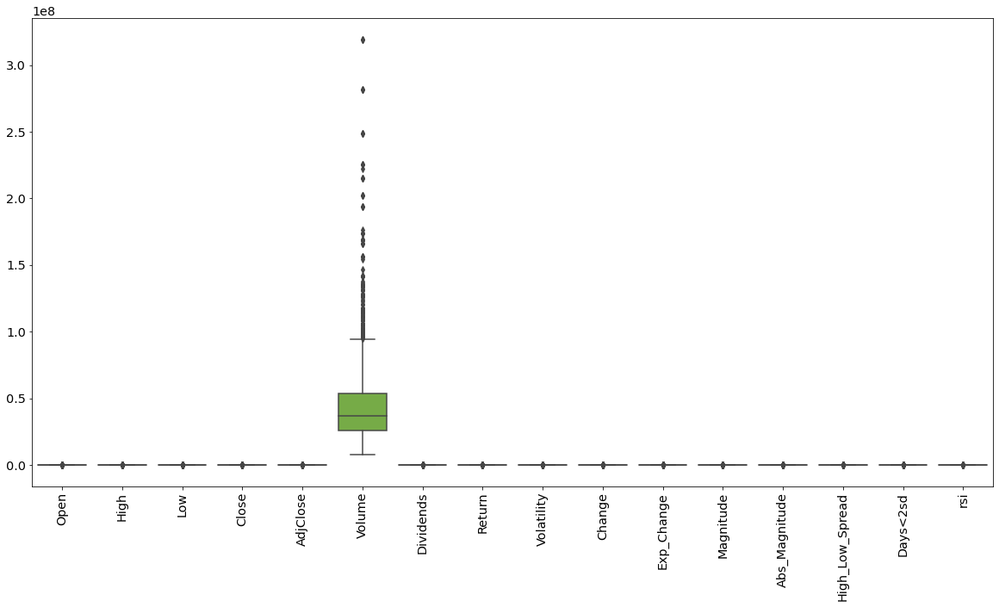

In [ ]:
sns.boxplot(data=data) #boxplot #outliers
plt.xticks(rotation=90)
plt.show()

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


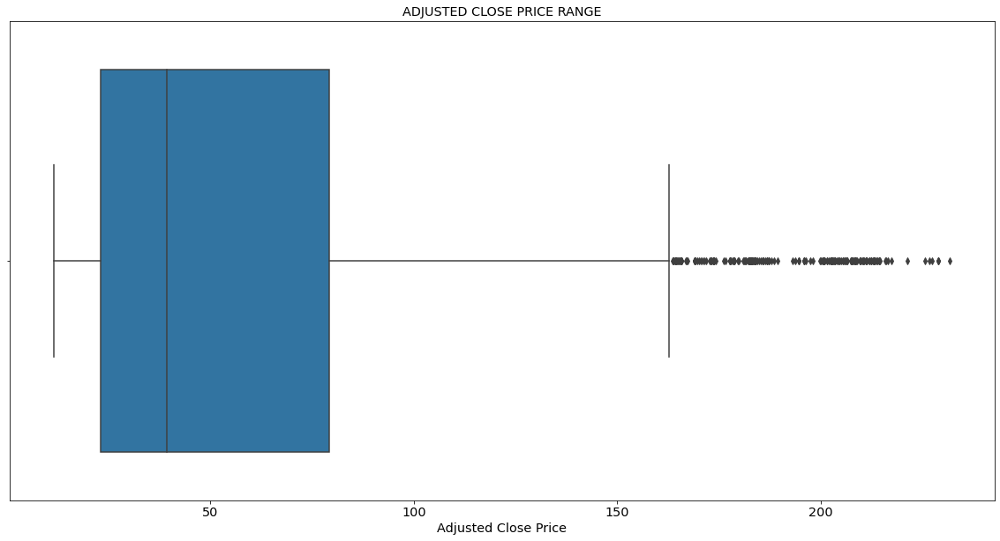

In [ ]:
sns.boxplot(data.AdjClose) #target
plt.title("ADJUSTED CLOSE PRICE RANGE")
plt.xlabel("Adjusted Close Price")
plt.show() 

## Exploratory Data Analysis

In [ ]:
import plotly.graph_objects as go

In [ ]:
fig = go.Figure(data=[go.Candlestick(
    x=data.index,
    open=data['Open'], high=data['High'],
    low=data['Low'], close=data['Close'],
    increasing_line_color= 'green', decreasing_line_color= 'red'
)])
fig.update_layout(
    title='Stock Market',
    yaxis_title='MSFT Stock')
fig.show() #There is a slider,You can zoom into dates by double click and slide the range.Check it out!Cool right! 

https://plotly.com/python/candlestick-charts/

In [ ]:
pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
  Created wheel for pandas-profiling: filename=pandas_profiling-2.9.0-py2.py3-none-any.whl size=258952 sha256=cd3a4f0e475de6974f0e3dd39a9b308af1a0e51c03c1a2783d2054891f36111b
  Stored in directory: /tmp/pip-ephem-wheel-cache-v2k6am1q/wheels/56/c2/dd/8d945b0443c35df7d5f62fa9e9ae105a2d8b286302b92e0109
Successfully built pandas-profiling


In [ ]:
from pandas_profiling import ProfileReport

In [ ]:
profile=ProfileReport(data,explorative=True,dark_mode=True)

In [ ]:
profile

# MODELING

## Feature Selection

**Method 1:**Forward Stepwise Selection

In [ ]:
data.columns

Index(['Open', 'High', 'Low', 'Close', 'AdjClose', 'Volume', 'Dividends',
       'Return', 'Volatility', 'Change', 'Exp_Change', 'Magnitude',
       'Abs_Magnitude', 'High_Low_Spread', 'Days<2sd', 'rsi'],
      dtype='object')

In [ ]:
var=['Volume', 'Dividends',
       'Return', 'Volatility', 'Change', 'Exp_Change', 'Magnitude',
       'Abs_Magnitude', 'High_Low_Spread', 'Days<2sd', 'rsi'] #all predictors except price

In [ ]:
from sklearn.feature_selection import f_regression #Univariate linear regression test

In [ ]:
X = np.array(data.loc[:,var])
y = np.array(data['AdjClose'])

features=f_regression(X,y,center=True) #gives row 0 as f-value and row 1 as p-value
features=pd.DataFrame(features,columns=var)
features.round(8) #round it to 6 decimal points I guess

,Volume,Dividends,Return,Volatility,Change,Exp_Change,Magnitude,Abs_Magnitude,High_Low_Spread,Days<2sd,rsi
0,492.559688,5.612226,3.004114,87.04661,11.839028,4937.560051,3.145592,1.322653,23.015477,3.791449,139.406783
1,0.000000,0.017880,0.083125,0.00000,0.000586,0.000000,0.076203,0.250180,0.000002,0.051580,0.000000


https://www.simplypsychology.org/p-value.html

In [ ]:
for i in features.columns:
  if np.abs(features.loc[1,i])>0.05: #|p-value|(both sides of population mean) is less = good predictor
    del features[i]


In [ ]:
features

,Volume,Dividends,Volatility,Change,Exp_Change,High_Low_Spread,rsi
0,4.925597e+02,5.612226,8.704661e+01,11.839028,4937.560051,23.015477,1.394068e+02
1,2.084785e-103,0.017880,1.653932e-20,0.000586,0.000000,0.000002,1.102885e-31


In [ ]:
var1=features.columns


In [ ]:
temp1=data.loc[:,var1]
temp1['AdjClose']=data.AdjClose

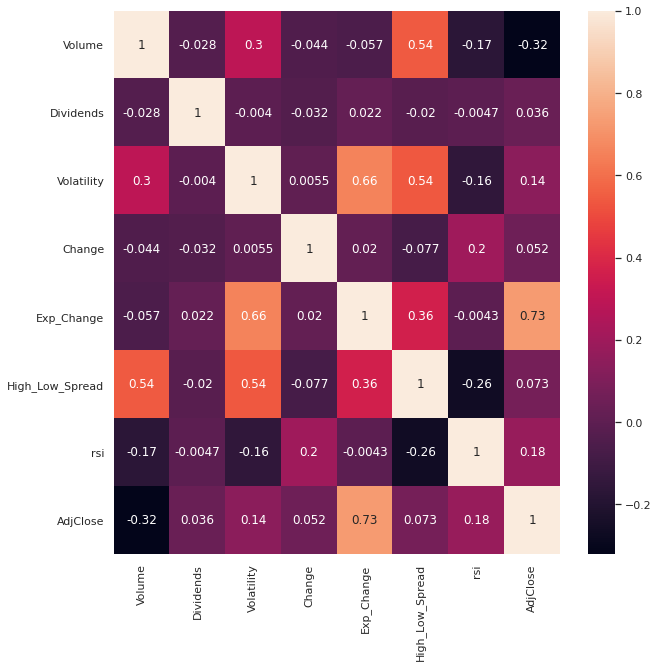

In [ ]:
  correlation_matrix = temp1.corr()
  sns.set(rc={'figure.figsize':(10,10)})
  sns_plot1=sns.heatmap(data=correlation_matrix, annot=True)
  fig = sns_plot1.get_figure()
  #fig.savefig("/content/drive/Shared drives/OPIM-5509-Introduction to Deep Learning/Project 1/Correlation matrix.png")

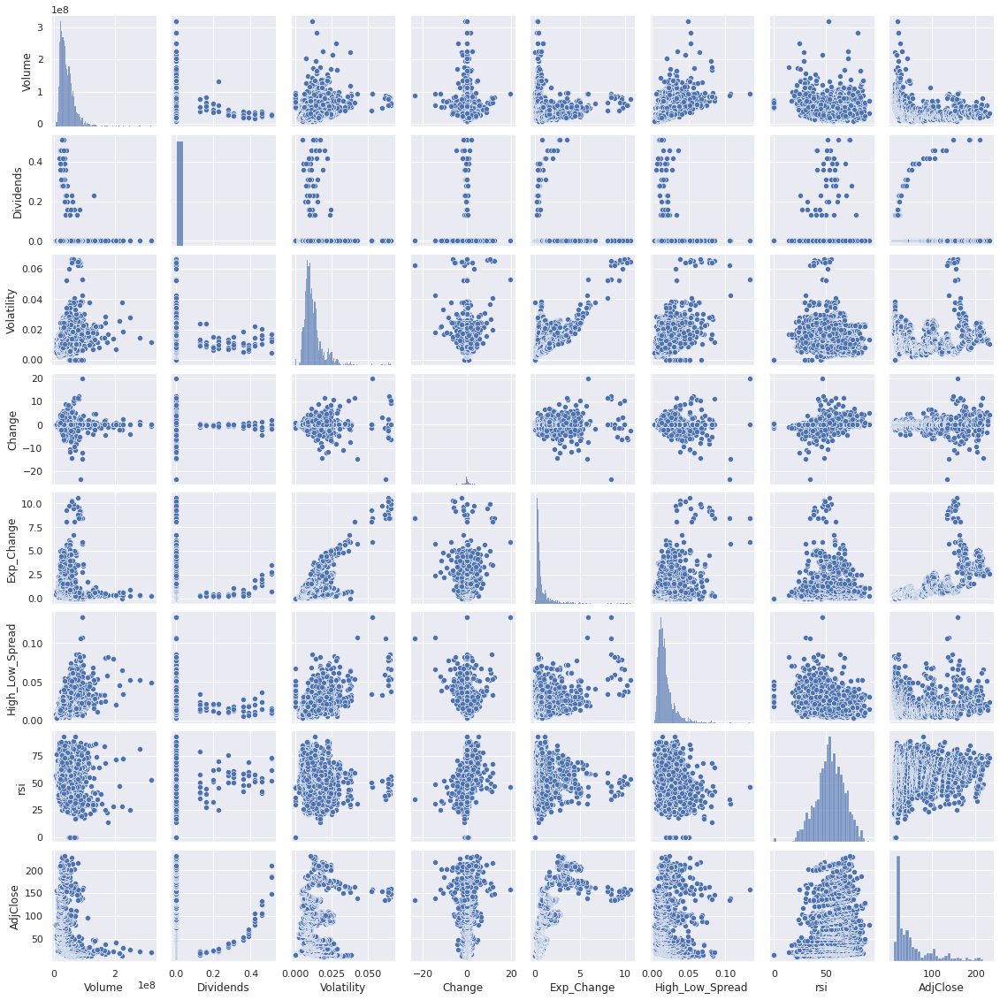

In [ ]:
sns.pairplot(temp1,height=2)
colors = "Reds"# Set your custom color palette
sns.set_palette(colors)
plt.show()

**Method2:**Handpicked predictors with |Correlation| $ \leq$ 0.45

In [ ]:
var2=['Volume','Dividends','rsi','Change', 'Abs_Magnitude','Days<2sd'] 

In [ ]:
temp2=data.loc[:,var2]
temp2['AdjClose']=data.AdjClose

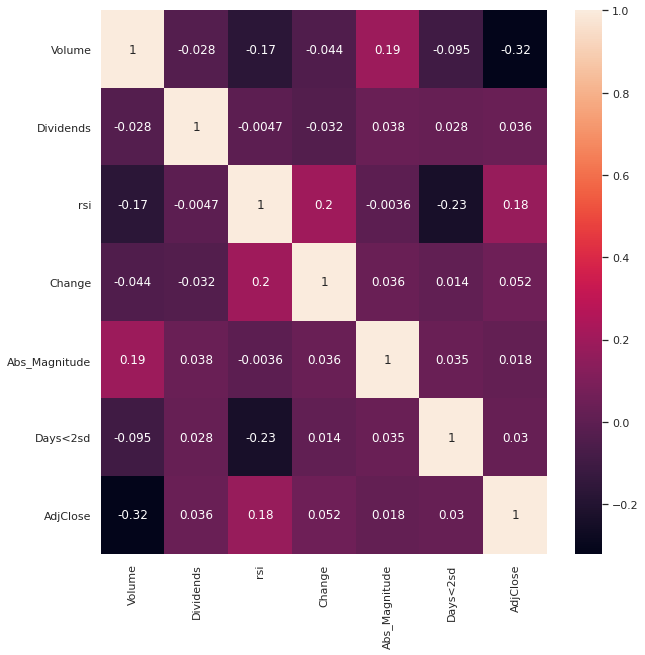

In [ ]:
  correlation_matrix2 = temp2.corr()
  sns.set(rc={'figure.figsize':(10,10)})
  sns_plot1=sns.heatmap(data=correlation_matrix2, annot=True)
  fig = sns_plot1.get_figure()
  #fig.savefig("/content/drive/Shared drives/OPIM-5509-Introduction to Deep Learning/Project 1/Correlation matrix.png")

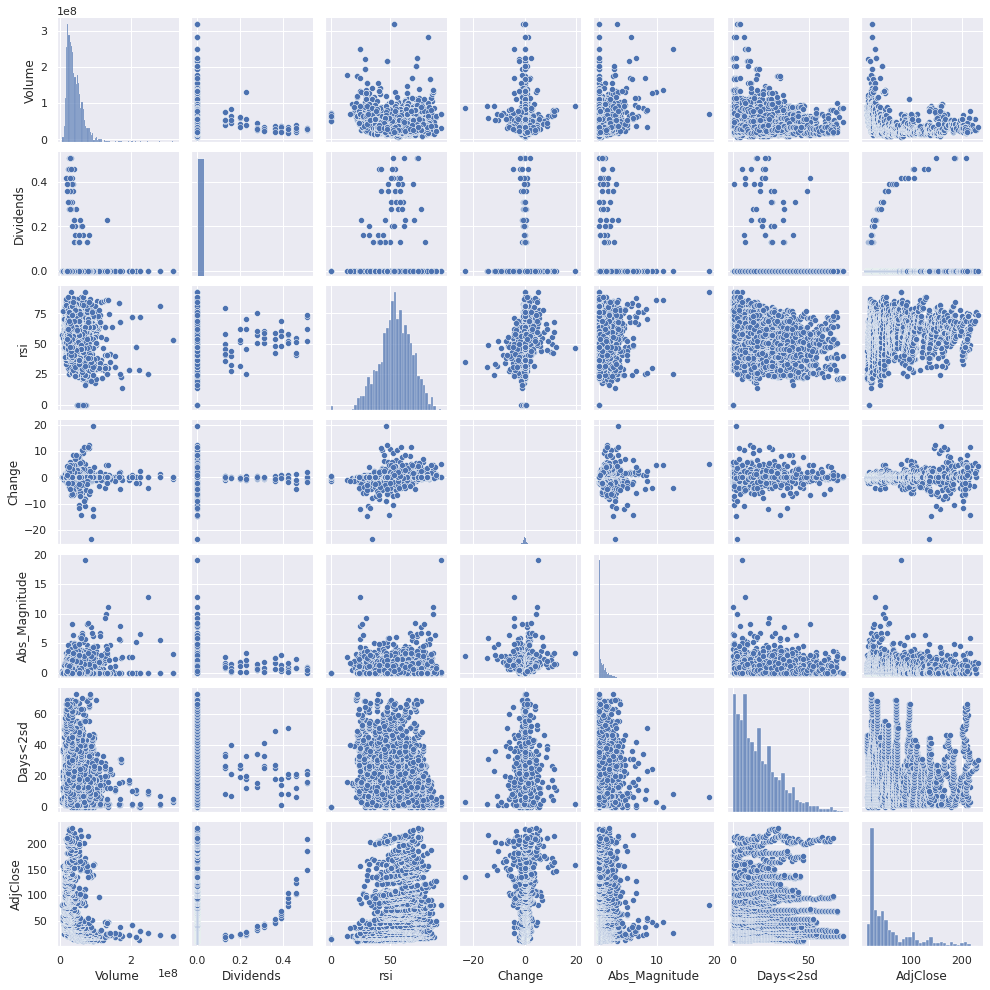

In [ ]:
sns.pairplot(temp2,height=2)
plt.show()

## DATA PARTITION

### For Linear Model and SVR Model:

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
X1=np.array(data[var1])
y1=np.array(data.AdjClose)

In [ ]:
X1_train, X1_test, y1_train, y1_test=train_test_split(X1,y1,test_size=0.2,random_state=123)

In [ ]:
scaler = MinMaxScaler() #transformation to get unbiased data as in pairplot
X1_train = scaler.fit_transform(X1_train)
X1_test = scaler.transform(X1_test)

### For FFNN Model:

In [ ]:
X2=np.array(data[var2])
y2=np.array(data.AdjClose)

In [ ]:
X2_train, X2_test, y2_train, y2_test=train_test_split(X2,y2,test_size=0.2,random_state=123)

In [ ]:
scaler = MinMaxScaler() #transformation to get unbiased data as in pairplot
X2_train = scaler.fit_transform(X1_train)
X2_test = scaler.transform(X1_test)

### For ARIMA Model:

In [ ]:
data1=data['AdjClose']

In [ ]:
 train_data, test_data =data1[0:int(len(data1)*0.8)], data1[int(len(data1)*0.8)-1:]

## Model Accuracy Stats

In [ ]:
from sklearn.metrics import mean_squared_error
from math import sqrt
import sklearn.metrics

In [ ]:
def rmse(y_actual, y_predicted):
  mae=sklearn.metrics.mean_absolute_error(y_actual, y_predicted)
  r2=sklearn.metrics.r2_score(y_actual, y_predicted)
  rmse = sqrt(mean_squared_error(y_actual, y_predicted))
  print("RMSE of the Model is "+str(rmse)+"\n"+"Mean Absolute Error of the Model is "+str(mae)+"\n"
        "R-Square of the Model is "+str(r2))
  return rmse


## LINEAR REGRESSION

In [ ]:
from sklearn.linear_model import LinearRegression

In [ ]:
linear=LinearRegression()
linear.fit(X1_train,y1_train)
train_preds=linear.predict(X1_train)
test_preds=linear.predict(X1_test)

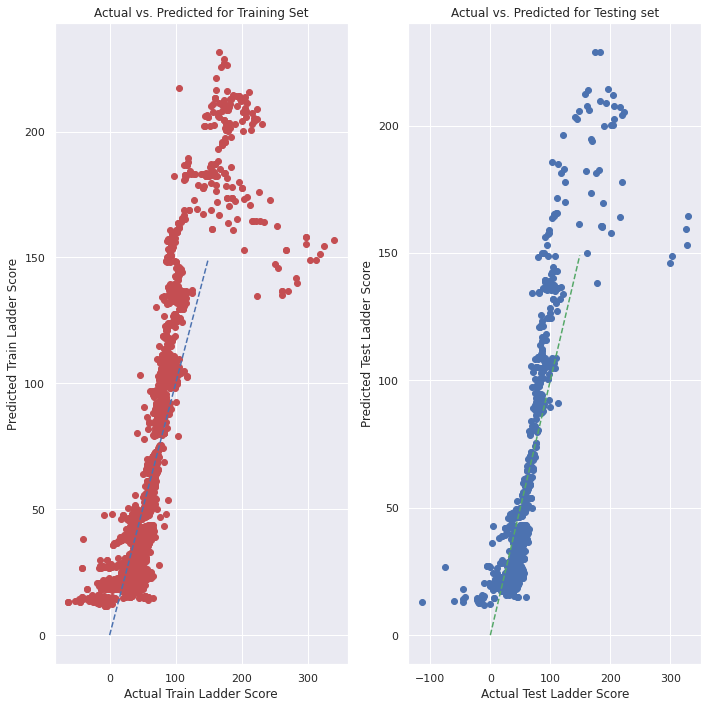

In [ ]:
figure, axes = plt.subplots(nrows=1, ncols=2)
axes[0].plot(train_preds,y1_train,'ro')
axes[0].set(xlabel='Actual Train Ladder Score',ylabel='Predicted Train Ladder Score')
axes[0].set_title('Actual vs. Predicted for Training Set')
axes[0].plot(range(150),range(150),'--b',) #line where actual = predicted

axes[1].plot(test_preds,y1_test,'bo',)
axes[1].set(xlabel='Actual Test Ladder Score',ylabel='Predicted Test Ladder Score')
axes[1].set_title('Actual vs. Predicted for Testing set')
axes[1].plot(range(150),range(150),'--g',) #line where actual = predicted
figure.tight_layout()
plt.show()


In [ ]:
rmse1=rmse(test_preds,y1_test)

RMSE of the Model is 25.173935969051655
Mean Absolute Error of the Model is 17.156109662048742
R-Square of the Model is 0.6658280343028345


## SVR MODEL

In [ ]:
from sklearn.svm import SVR

In [ ]:
svr=SVR()
svr.fit(X1_train,y1_train)
train_preds1=svr.predict(X1_train)
test_preds1=svr.predict(X1_test)

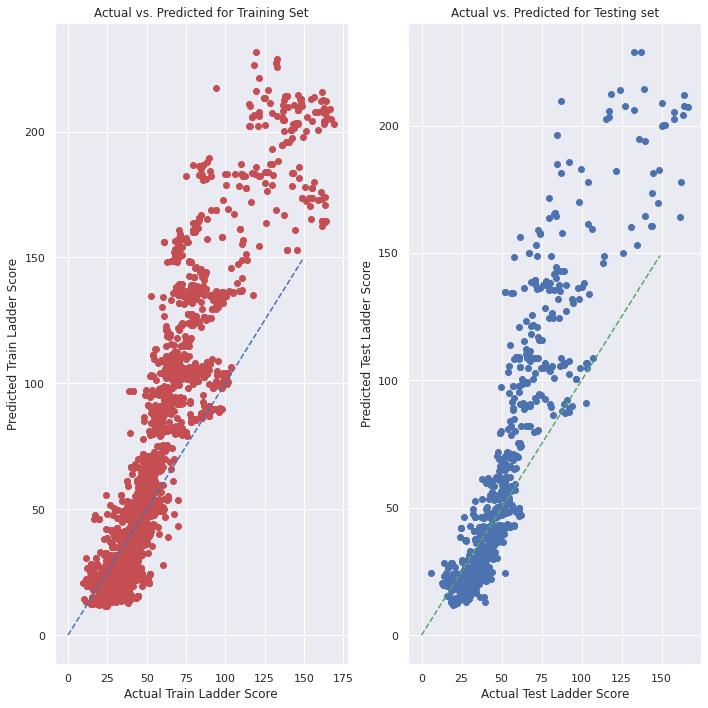

In [ ]:
figure, axes = plt.subplots(nrows=1, ncols=2)
axes[0].plot(train_preds1,y1_train,'ro')
axes[0].set(xlabel='Actual Train Ladder Score',ylabel='Predicted Train Ladder Score')
axes[0].set_title('Actual vs. Predicted for Training Set')
axes[0].plot(range(150),range(150),'--b',) #line where actual = predicted

axes[1].plot(test_preds1,y1_test,'bo',)
axes[1].set(xlabel='Actual Test Ladder Score',ylabel='Predicted Test Ladder Score')
axes[1].set_title('Actual vs. Predicted for Testing set')
axes[1].plot(range(150),range(150),'--g',) #line where actual = predicted
figure.tight_layout()
plt.show()

In [ ]:
rmse2=rmse(test_preds1,y1_test)

RMSE of the Model is 27.12071847895923
Mean Absolute Error of the Model is 17.013505883975785
R-Square of the Model is 0.06048994677011732


## FFNN REGRESSION MODEL

In [ ]:
X2_train.shape[1]

7

In [ ]:
from keras.models import Sequential
from keras.layers import Dense

In [ ]:
# this simply sets up the model
model = Sequential()
# this is hidden layer 1
model.add(Dense(64, activation='relu', input_shape=(X2_train.shape[1],))) # input shape is = (features,)
# this is hidden layer 2
model.add(Dense(64, activation='relu'))
# this is the output node
model.add(Dense(1, activation='linear')) # the activation function here is 'linear' by default
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 64)                512       
_________________________________________________________________
dense_1 (Dense)              (None, 64)                4160      
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 65        
Total params: 4,737
Trainable params: 4,737
Non-trainable params: 0
_________________________________________________________________


In [ ]:
# compiles the model, specifies model evaluation metrics

model.compile(optimizer='rmsprop', loss='mse', metrics=['mae'])

In [ ]:
# simple early stopping
from keras.callbacks import EarlyStopping
es = EarlyStopping(monitor='val_loss', mode='min', 
                   patience=10, 
                   verbose=1,
                   restore_best_weights=True) 
# fit model
history = model.fit(X2_train, y2_train, 
                    validation_data=(X2_test, y2_test), 
                    epochs=4000, 
                    batch_size = 10,
                    verbose=1, 
                    callbacks=[es]) #notice we won't have to manually watch it
                    

Epoch 1/4000
344/344 [==============================] - 1s 2ms/step - loss: 3310.8784 - mae: 40.7754 - val_loss: 2114.5120 - val_mae: 36.0752
Epoch 2/4000
344/344 [==============================] - 0s 1ms/step - loss: 1958.3655 - mae: 34.6705 - val_loss: 1830.0031 - val_mae: 34.2411
Epoch 3/4000
344/344 [==============================] - 0s 1ms/step - loss: 1606.8400 - mae: 31.4469 - val_loss: 1403.4391 - val_mae: 29.0114
Epoch 4/4000
344/344 [==============================] - 0s 1ms/step - loss: 1139.5592 - mae: 25.8732 - val_loss: 996.1680 - val_mae: 25.0763
Epoch 5/4000
344/344 [==============================] - 0s 1ms/step - loss: 827.4272 - mae: 21.2788 - val_loss: 818.1641 - val_mae: 20.0873
Epoch 6/4000
344/344 [==============================] - 0s 1ms/step - loss: 709.6526 - mae: 18.9247 - val_loss: 763.6320 - val_mae: 18.7367
Epoch 7/4000
344/344 [==============================] - 0s 1ms/step - loss: 655.6218 - mae: 17.4093 - val_loss: 691.8841 - val_mae: 17.2858
Epoch 8/4000


In [ ]:
history_dict = history.history
history_dict.keys() 

# out of all of these, let's plot the val_mean_absolute_error

dict_keys(['loss', 'mae', 'val_loss', 'val_mae'])

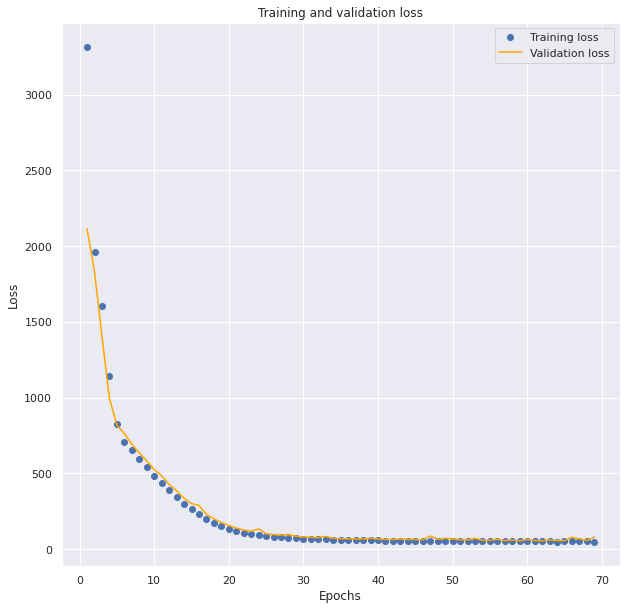

In [ ]:
# let's see the training and validation accuracy by epoch
history_dict = history.history
loss_values = history_dict['loss'] # you can change this
val_loss_values = history_dict['val_loss'] # you can also change this
epochs = range(1, len(loss_values) + 1) # range of X (no. of epochs)
plt.plot(epochs, loss_values, 'bo', label='Training loss')
plt.plot(epochs, val_loss_values, 'orange', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
resultDF = pd.DataFrame(history_dict)
resultDF.head()

,loss,mae,val_loss,val_mae
0,3310.878418,40.775425,2114.511963,36.075153
1,1958.365479,34.670517,1830.003052,34.241100
2,1606.839966,31.446915,1403.439087,29.011389
3,1139.559204,25.873182,996.168030,25.076286
4,827.427246,21.278849,818.164124,20.087309


In [ ]:
resultDF.loc[resultDF['val_loss'] == min(resultDF['val_loss'])]

,loss,mae,val_loss,val_mae
58,52.091633,3.862663,55.439476,3.881402


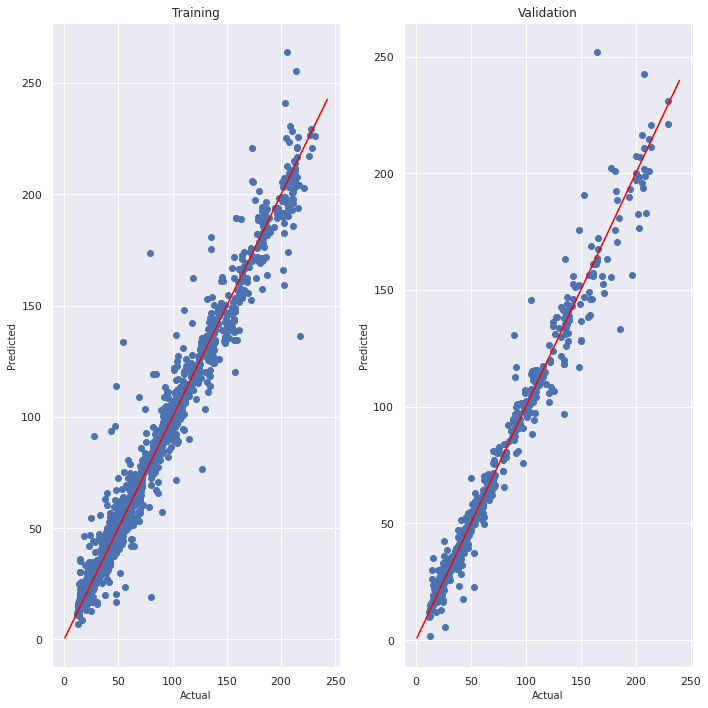

In [ ]:
# scatterplot of actual vs. pred
# specify the dimensions 
fig, axes = plt.subplots(1,2) # 1 row, 2 columns

# this makes the individual subplots
# Training Results
axes[0].scatter(x=y2_train, y=model.predict(X2_train)) #first row, first entry (left top)
axes[0].set_xlabel("Actual", fontsize=10)
axes[0].set_ylabel("Predicted",  fontsize=10)
axes[0].set_title("Training")
# add 45 deg line
x = np.linspace(*axes[0].get_xlim())
axes[0].plot(x, x, color='red')
# Validation Results
axes[1].scatter(x=y2_test, y=model.predict(X2_test)) # first row, second entry (right top)
axes[1].set_xlabel("Actual", fontsize=10)
axes[1].set_ylabel("Predicted",  fontsize=10)
axes[1].set_title("Validation")
# add 45 deg line
x = np.linspace(*axes[1].get_xlim())
axes[1].plot(x, x, color='red')

# tight layout
fig.tight_layout()


# show the plot
plt.show()

In [ ]:
test_preds2=model.predict(X2_test)

In [ ]:
rmse3=rmse(test_preds2,y2_test)

RMSE of the Model is 7.445769066008159
Mean Absolute Error of the Model is 3.881403432227494
R-Square of the Model is 0.975703794316151


## ARIMA MODEL

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf  #autocorrelation
from statsmodels.tsa.stattools import adfuller as ADF  # stable test
from statsmodels.graphics.tsaplots import plot_pacf    #pacf
from statsmodels.stats.diagnostic import acorr_ljungbox    #white noise
from statsmodels.tsa.arima_model import ARIMA

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



### STATIONARITY TEST

A TimeSeries is said to be stationary if its statistical properties such as mean variance remain constant over time.

In [ ]:
plt.clf()
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 20,10
params = {'legend.fontsize': 'x-large',
            'axes.labelsize': 'x-large',
          'axes.titlesize':'x-large',
          'xtick.labelsize':'x-large',
          'ytick.labelsize':'x-large'}
rcParams.update(params)

<Figure size 720x720 with 0 Axes>

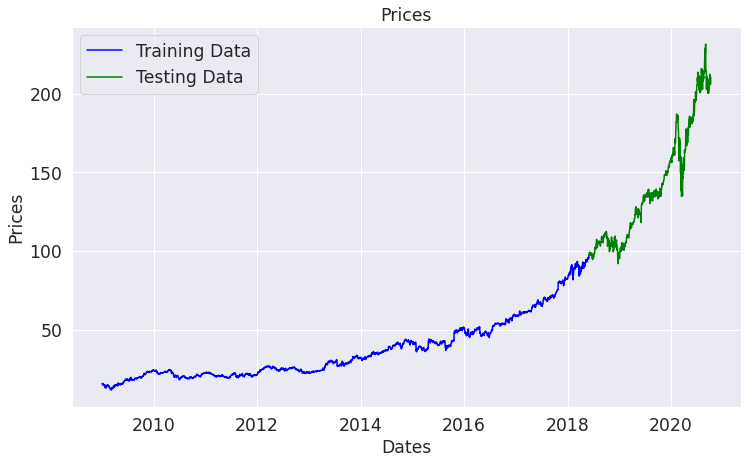

In [ ]:
plt.figure(figsize=(12,7))
plt.title('Prices')
plt.xlabel('Dates')
plt.ylabel('Prices')
plt.plot(train_data, 'blue', label='Training Data')
plt.plot(test_data, 'green', label='Testing Data')
plt.legend()

In [ ]:
from statsmodels.tsa.stattools import adfuller
def test_stationarity(timeseries):
    
    #Determing rolling statistics
    rolmean = pd.Series(timeseries).rolling(window=12).mean()
    rolstd = pd.Series(timeseries).rolling(window=12).std()

    #Plot rolling statistics:
    plt.style.use('seaborn')
    rcParams['figure.figsize'] = 20,10
    orig = plt.plot(timeseries,label='Original')
    mean = plt.plot(rolmean, label='Rolling Mean')
    std = plt.plot(rolstd, label = 'Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey-Fuller test:
    print('Results of Dickey-Fuller Test:')
    dftest = adfuller(timeseries, autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

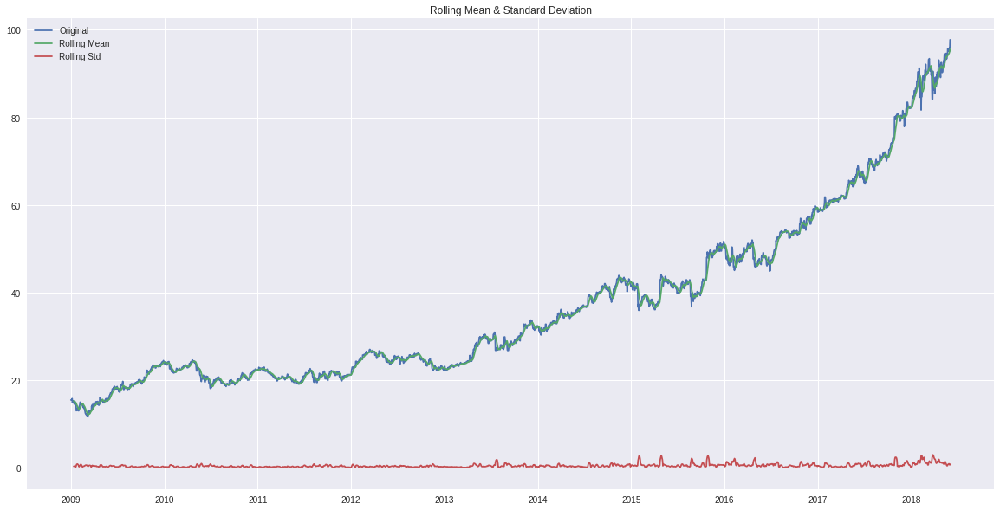

Results of Dickey-Fuller Test:
Test Statistic                    3.211001
p-value                           1.000000
#Lags Used                       17.000000
Number of Observations Used    3421.000000
Critical Value (1%)              -3.432263
Critical Value (5%)              -2.862385
Critical Value (10%)             -2.567220
dtype: float64


In [ ]:
test_stationarity(train_data)

Not stationary, the test statistic is way more than the critical values, p-value is too big.

Try to make it Stationary

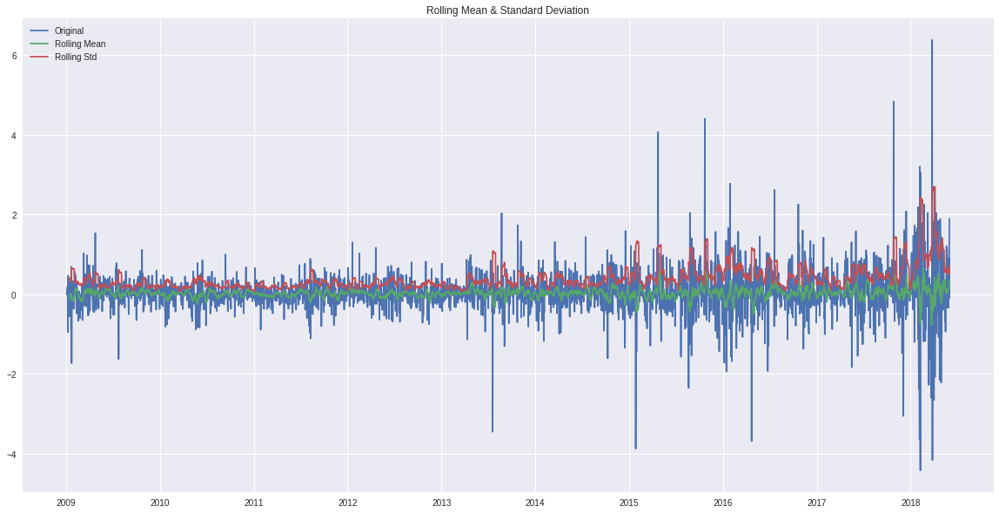

Results of Dickey-Fuller Test:
Test Statistic                -1.538335e+01
p-value                        3.384454e-28
#Lags Used                     1.600000e+01
Number of Observations Used    3.421000e+03
Critical Value (1%)           -3.432263e+00
Critical Value (5%)           -2.862385e+00
Critical Value (10%)          -2.567220e+00
dtype: float64


In [ ]:
D_df = train_data.diff().dropna()
test_stationarity(D_df)
D_df=pd.DataFrame(D_df)
D_df.columns = ['df diff']

### STABILITY TEST

In [ ]:
#After First order difference, it shows stable fluctuation, it has strong Short-term correlation,
ADF_D_df_p =ADF(D_df['df diff'])[1]
print("p-value of first order difference sequence adf test is "+str(ADF_D_df_p))
#the unit root test p value is less than 0.05,
#so the sequence after the first order difference is a stable sequence

p-value of first order difference sequence adf test is 3.384454252452995e-28


### ACF AND PACF 

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf  #autocorrelation
from statsmodels.tsa.stattools import adfuller as ADF  # stable test
from statsmodels.graphics.tsaplots import plot_pacf    #pacf
from statsmodels.stats.diagnostic import acorr_ljungbox    #white noise
from statsmodels.tsa.arima_model import ARIMA

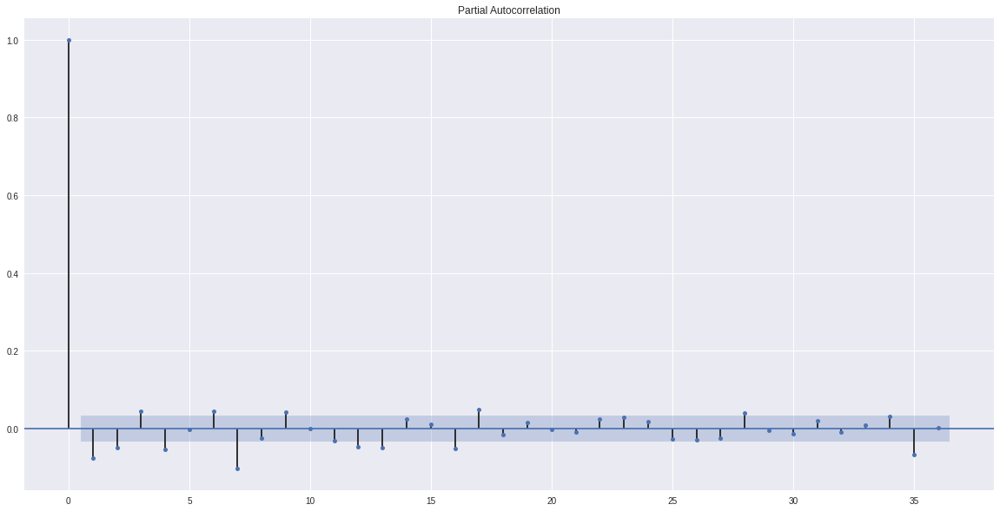

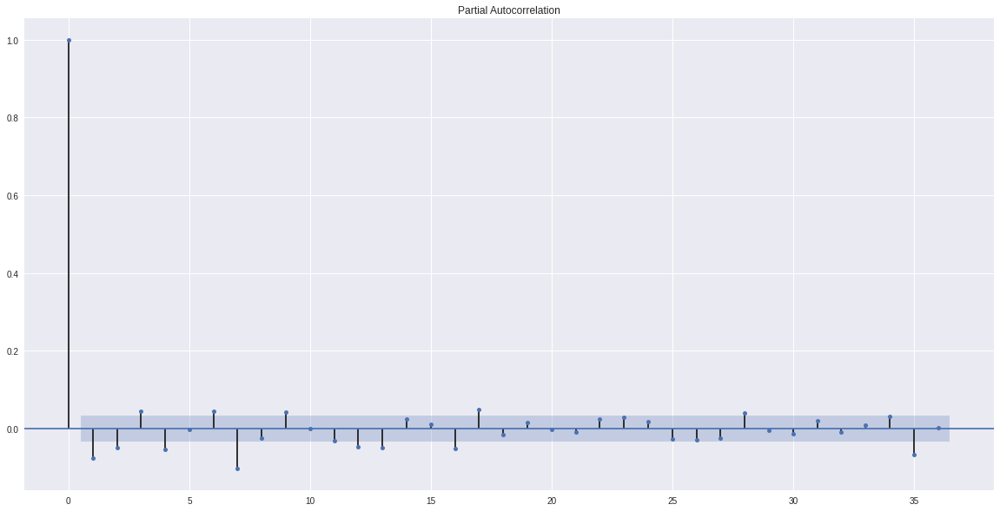

In [ ]:
plot_pacf(D_df)

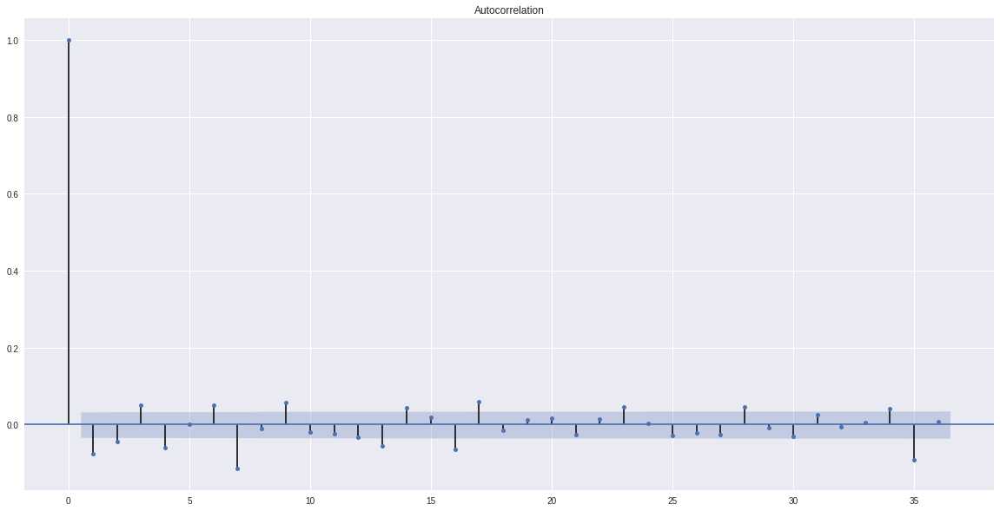

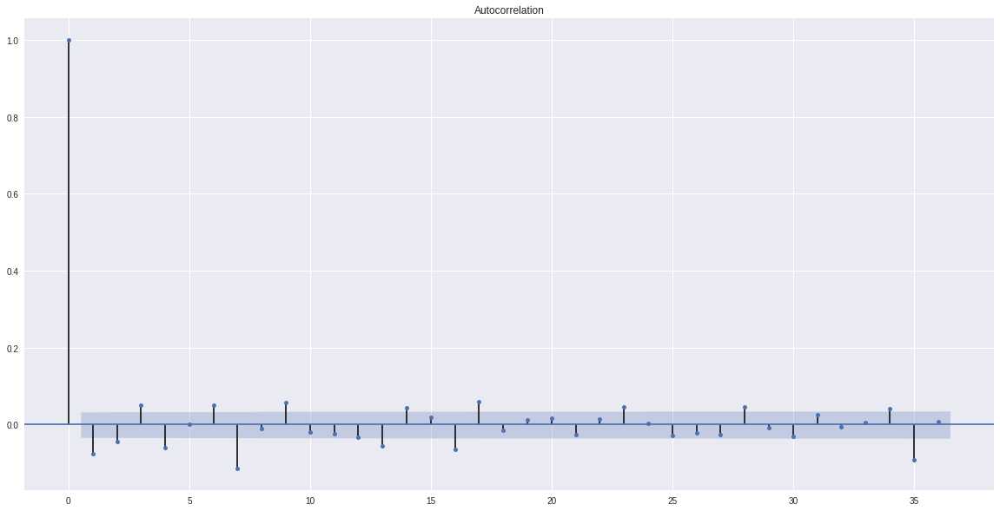

In [ ]:
plot_acf(D_df) 

### WHITE NOISE TEST

In [ ]:
from statsmodels.tsa.stattools import acf, pacf
from scipy.ndimage.interpolation import shift
from statsmodels.tsa.arima_model import ARIMA

In [ ]:
wn=acorr_ljungbox(D_df, lags=1)
print("The p-value of White Noise test of first order difference is "+ str(wn[1][0]))
#<0.05 stable and not white noise

The p-value of White Noise test of first order difference is 8.740795911600918e-06


### AUTO-ARIMA

In [ ]:
from statsmodels.tsa.arima_model import ARIMA

In [ ]:
!pip install pyramid-arima
from pyramid.arima import auto_arima

     |████████████████████████████████| 604kB 2.8MB/s 


/usr/local/lib/python3.6/dist-packages/sklearn/externals/six.py:31: FutureWarning:

The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).

/usr/local/lib/python3.6/dist-packages/sklearn/externals/joblib/__init__.py:15: FutureWarning:

sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.

/usr/local/lib/python3.6/dist-packages/pyramid/__init__.py:68: UserWarning:


    The 'pyramid' package will be migrating to a new namespace beginning in 
    version 1.0.0: 'pmdarima'. This is due to a package name collision with the
    Pyramid web framework. For more information, see Issue #34:
    
        https:/

In [ ]:
def armodel(train_data,test_data):
    aa=auto_arima(train_data,start_p=1, start_q=1, max_p=2, max_q=2,m=12,start_P=1,start_Q=1,seasonal=True,d=1, D=1, trace=True,error_action='ignore',  suppress_warnings=True, stepwise=True)
    train_ar = train_data.values
    test_ar = test_data.values
    history = [x for x in train_ar]
    print(history)
    predictions = list()
    for t in range(len(test_ar)):
      model = ARIMA(history,order=(aa.order))
      model_fit = model.fit()
      output = model_fit.forecast()
      yhat = output[0]
      predictions.append(yhat)
      obs = test_ar[t]
      history.append(obs)
    error = mean_squared_error(test_ar, predictions)
    rmse=sqrt(error)
    plt.plot(train_data,color='green', label='Training Data')
    plt.plot(test_data.index, predictions, marker='o', linestyle='dashed', 
    label='Predicted Price')
    plt.plot(test_data.index, test_data, color='red', label='Actual Price')
    plt.title('Price Prediction')
    plt.xlabel('Dates')
    plt.ylabel('Prices')
    plt.legend()
    plt.show()
    predictions=pd.DataFrame(predictions)
    return predictions,rmse

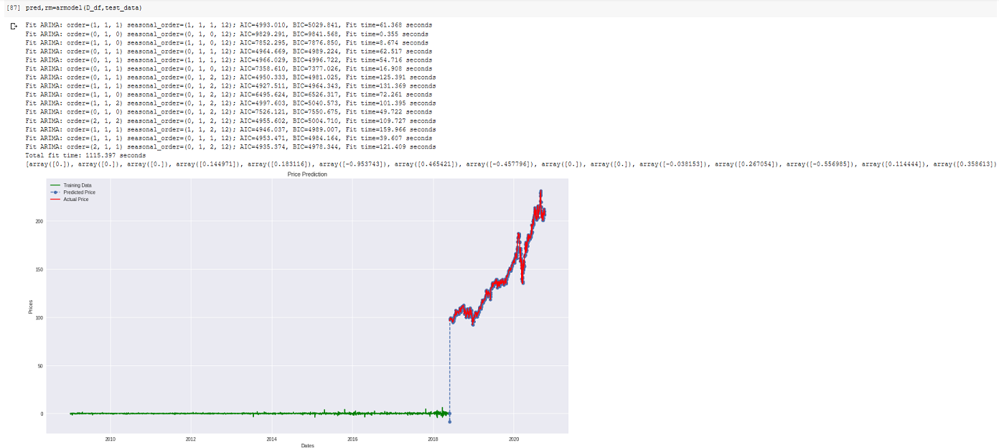

This takes a lot of time(1115.397s~18min).It crashes sometimes as the process is random but we will get high performance time series model finally.

In [ ]:
#pred,rm=armodel(D_df,test_data)

In [ ]:
#pred.to_csv('/content/drive/Shared drives/OPIM-5509-Introduction to Deep Learning/pre.csv')
pred=pd.read_csv('/content/drive/Shared drives/OPIM-5509-Introduction to Deep Learning/Project 1/Python code/pre.csv')
#pred=pd.read_csv(p)

In [ ]:
rm=5.5296998992853865

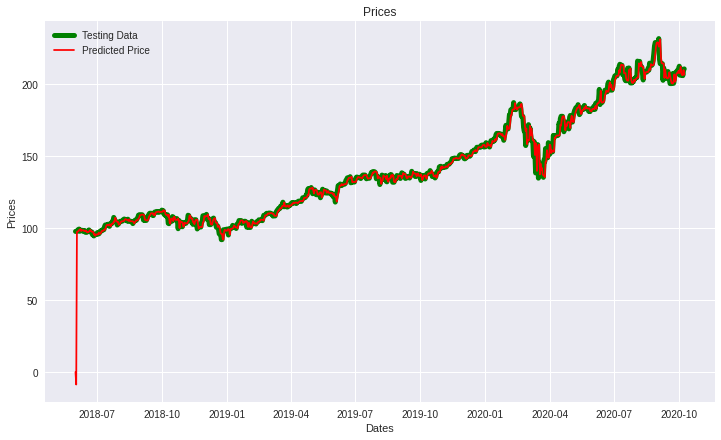

In [ ]:
plt.figure(figsize=(12,7))
plt.title('Prices')
plt.xlabel('Dates')
plt.ylabel('Prices')
plt.plot(test_data, 'green', label='Testing Data',linewidth=5)
plt.plot(test_data.index,pred['0'], 'red', label='Predicted Price')
plt.legend()
plt.show()

In [ ]:
pred=pred['0']

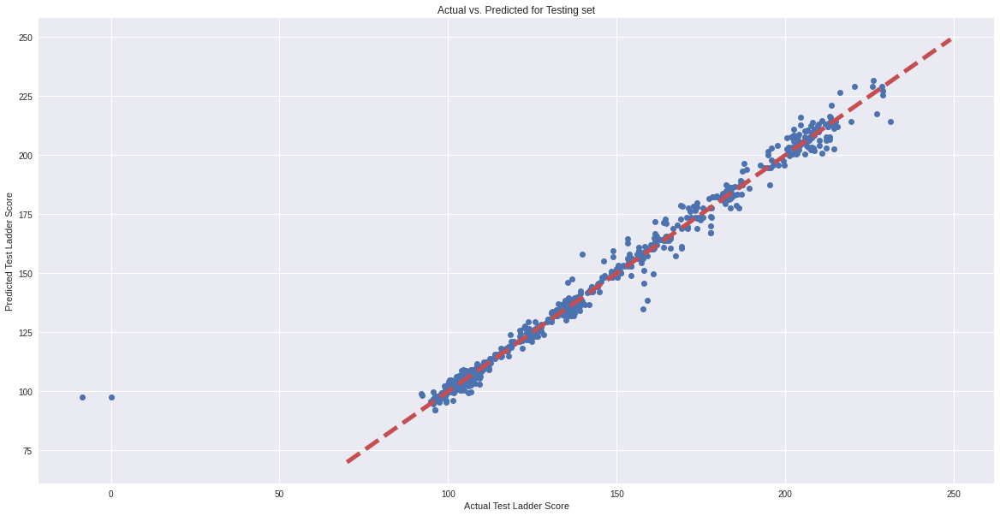

In [ ]:
plt.plot(pred,test_data,'bo',)
plt.xlabel('Actual Test Ladder Score')
plt.ylabel('Predicted Test Ladder Score')
plt.title('Actual vs. Predicted for Testing set')
plt.plot(range(70,250),range(70,250),'--r',linewidth=5) #line where actual = predicted
figure.tight_layout()
plt.show()


In [ ]:
rmse4=rm
rmse4

5.5296998992853865

In [ ]:
rmse4=rmse(test_data,pred)

RMSE of the Model is 5.857547938356459
Mean Absolute Error of the Model is 2.195555714840101
R-Square of the Model is 0.9739205464769772


https://alkaline-ml.com/pmdarima/0.9.0/modules/generated/pyramid.arima.auto_arima.html

https://otexts.com/fpp2/seasonal-arima.html

https://medium.com/@josemarcialportilla/using-python-and-auto-arima-to-forecast-seasonal-time-series-90877adff03c

## Baseline Model  

In [ ]:
data['Baseline']=data['AdjClose'].mean()

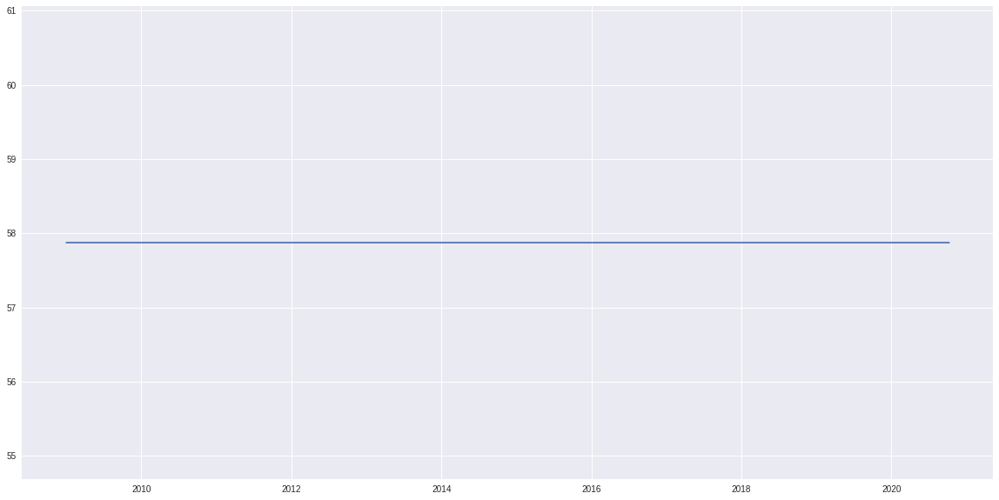

In [ ]:
plt.plot(data['Baseline'])

In [ ]:
tempB=data['Baseline']

In [ ]:
 trainB, testB =tempB[0:int(len(tempB)*0.8)], tempB[int(len(tempB)*0.8)-1:] #Any split is the same #prediction is same

In [ ]:
rmse5=rmse(test_data,testB)

RMSE of the Model is 90.646568418439
Mean Absolute Error of the Model is 83.07329316577152
R-Square of the Model is -5.245533170131229


## Baseline Time series models 

> Not included in Model Comparison

In [ ]:
data['21-day'] = data.AdjClose.rolling(21).mean() #This model gives best performance for MSFT stocks overall RMSE was approximately 5.
data['63-day'] = data.AdjClose.rolling(63).mean()

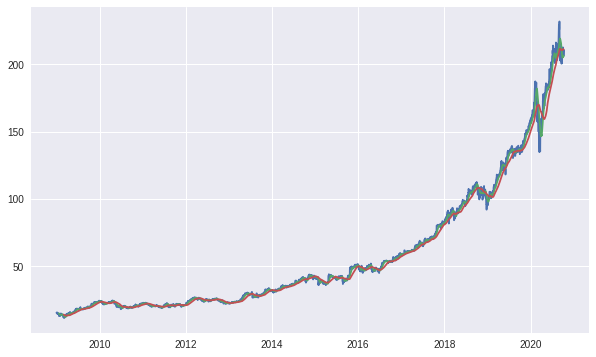

In [ ]:
plt.rcParams["figure.figsize"] = (10,6)
plt.plot(data[['AdjClose', '21-day', '63-day']])


#### Bollinger Bands - Volatility

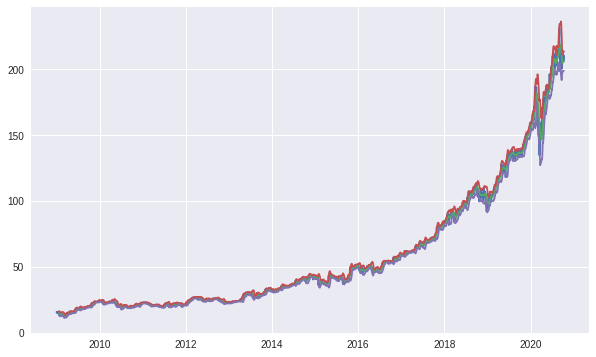

In [ ]:
data['std'] = data['AdjClose'].rolling(21).std()
plt.plot(data["AdjClose"])
plt.plot(data["21-day"])
plt.plot(data['21-day'] + 2 * data['std'])
plt.plot(data['21-day'] - 2 * data['std'])


In [ ]:
data.fillna(0,inplace=True) #imputation for head rows
tmp=data.iloc[:,-3:]
tmp['AdjClose']=data['AdjClose']

In [ ]:
 tr, te =tmp[0:int(len(tmp)*0.8)], tmp[int(len(tmp)*0.8)-1:]

In [ ]:
rmse(te['AdjClose'],te['21-day']) #21days

RMSE of the Model is 5.151530294272557
Mean Absolute Error of the Model is 3.5897489626680557
R-Square of the Model is 0.979828448661947


5.151530294272557

In [ ]:
rmse(te['AdjClose'],te['63-day']) #63days

RMSE of the Model is 8.670923984519984
Mean Absolute Error of the Model is 6.685836878896907
R-Square of the Model is 0.9428524598406361


8.670923984519984

In [ ]:
rmse(te['AdjClose'],te['std'])    #std

RMSE of the Model is 142.16446169846924
Mean Absolute Error of the Model is 137.77668207864903
R-Square of the Model is -14.362039361848293


142.16446169846924

# RESULTS AND DISCUSSION

## Model Comparison

### Residual Comparison

In [ ]:
plt.clf()
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 20,10
params = {'legend.fontsize': 'x-large',
            'axes.labelsize': 'x-large',
          'axes.titlesize':'x-large',
          'xtick.labelsize':'x-large',
          'ytick.labelsize':'x-large'}
rcParams.update(params)

<Figure size 720x432 with 0 Axes>

In [ ]:
fnn=pd.DataFrame(np.subtract(y2_test,test_preds2.T).T)
fnn

,0
0,-0.005522
1,-0.268017
2,1.294151
3,0.349392
4,-1.361794
...,...
855,-1.489177
856,9.198544
857,-2.734078
858,-9.130486


In [ ]:
def box(y1_test,y2_test,test_preds,test_preds1,test_preds2,test_data,pred,testB):
  linear=pd.DataFrame(np.subtract(y1_test,test_preds))
  svr=pd.DataFrame(np.subtract(y1_test,test_preds1))
  fnn=pd.DataFrame(np.subtract(y2_test,test_preds2.T).T)
  ar=pd.DataFrame(np.subtract(test_data.values,pred))
  b1=pd.DataFrame(np.subtract(test_data.values,testB))
  b1.index=range(len(b1))
  #Our goal is to find the range and frequency of residuals so index/order of the data doesn't matter

  residuals=pd.DataFrame()
  residuals=pd.concat([linear,svr,fnn,ar,b1],axis=1)
  residuals.columns=['LINEAR REGRESSION','SVR MODEL','FNN REGRESSION MODEL','ARIMA MODEL','BASELINE']
  residuals=residuals.fillna(0)

  
  warnings.filterwarnings("ignore")
  figure, axes = plt.subplots(nrows=5, ncols=1)
  
  axes[0].hist(residuals['LINEAR REGRESSION'])
  axes[0].set(ylabel='Linear Regression',xlabel='Residuals')
  axes[0].set_title('LINEAR REGRESSION')

  axes[1].hist(residuals['SVR MODEL'])
  axes[1].set(ylabel='SVR Model',xlabel='Residuals')
  axes[1].set_title('SVR MODEL')

  axes[2].hist(residuals['FNN REGRESSION MODEL'])
  axes[2].set(ylabel='FNN Regression',xlabel='Residuals')
  axes[2].set_title('FNN REGRESION MODEL')

  axes[3].hist(residuals['ARIMA MODEL'])
  axes[3].set(ylabel='ARIMA Model',xlabel='Residuals')
  axes[3].set_title('ARIMA MODEL')

  axes[4].hist(residuals['BASELINE'])
  axes[4].set(ylabel='Baseline Model',xlabel='Residuals')
  axes[4].set_title('BASELINE')

  figure.tight_layout()
  plt.show()
  return residuals

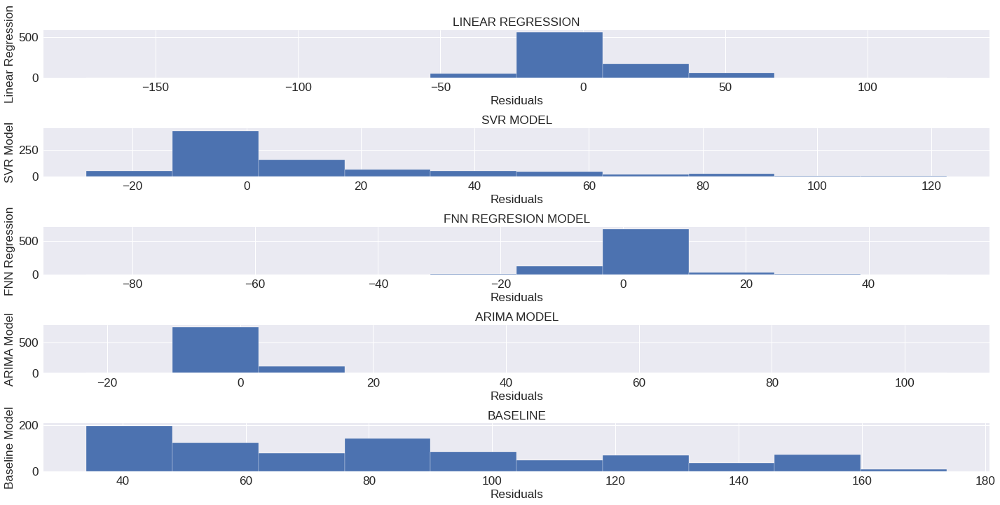

In [ ]:
residuals=box(y1_test,y2_test,test_preds,test_preds1,test_preds2,test_data,pred,testB)

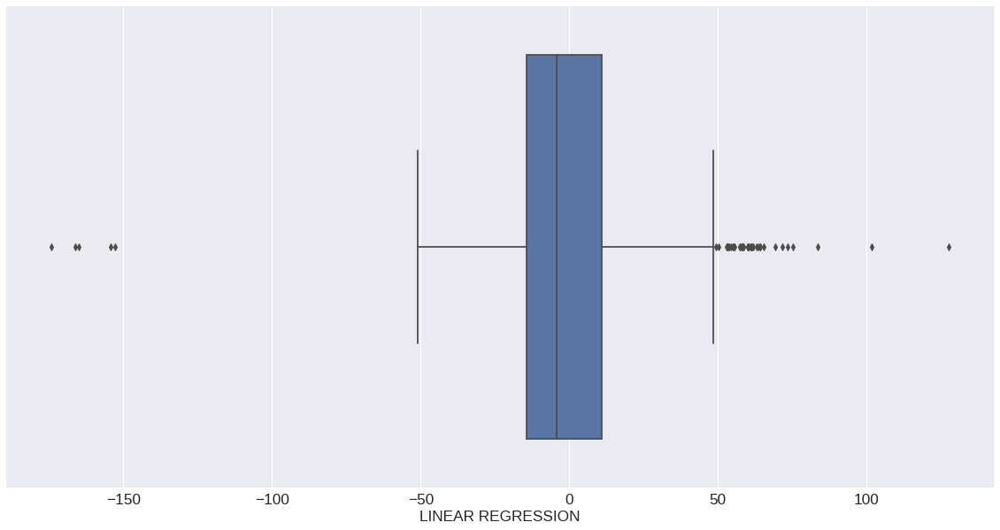

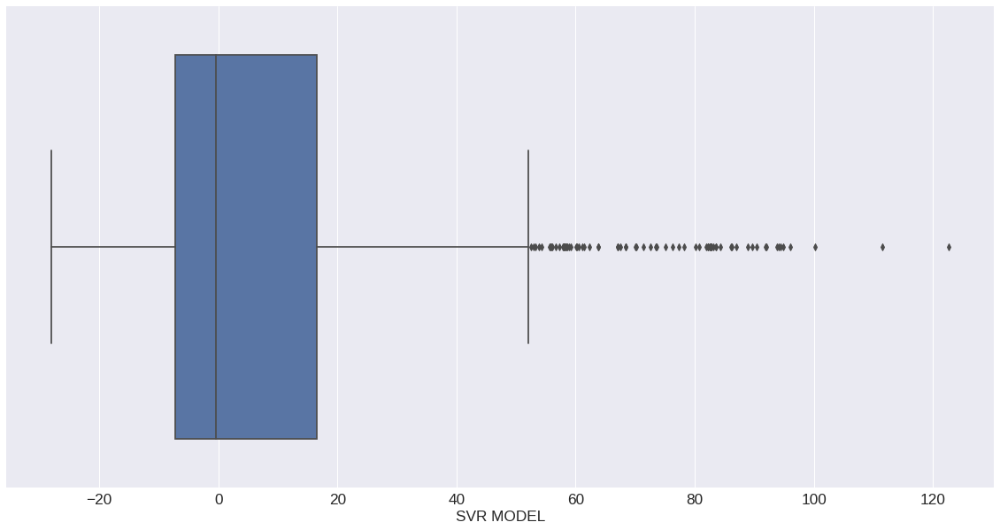

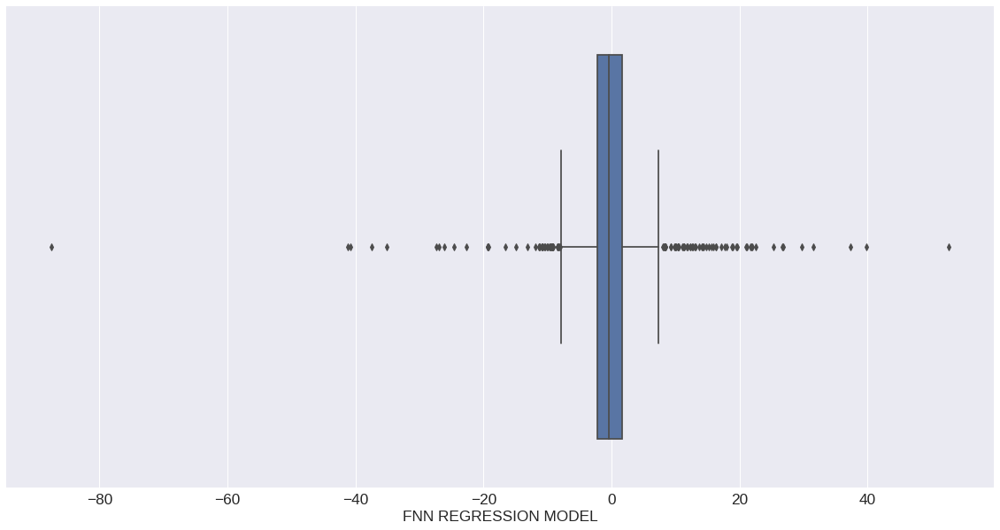

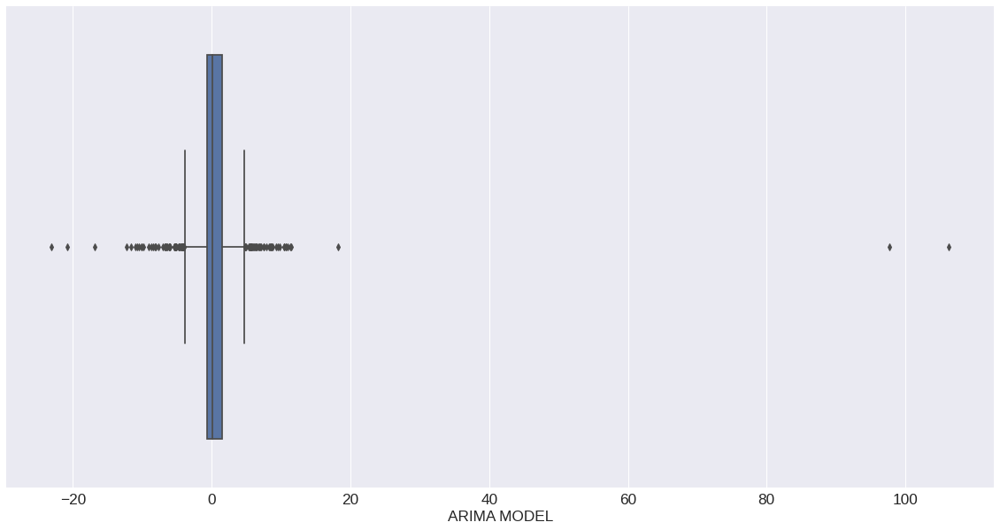

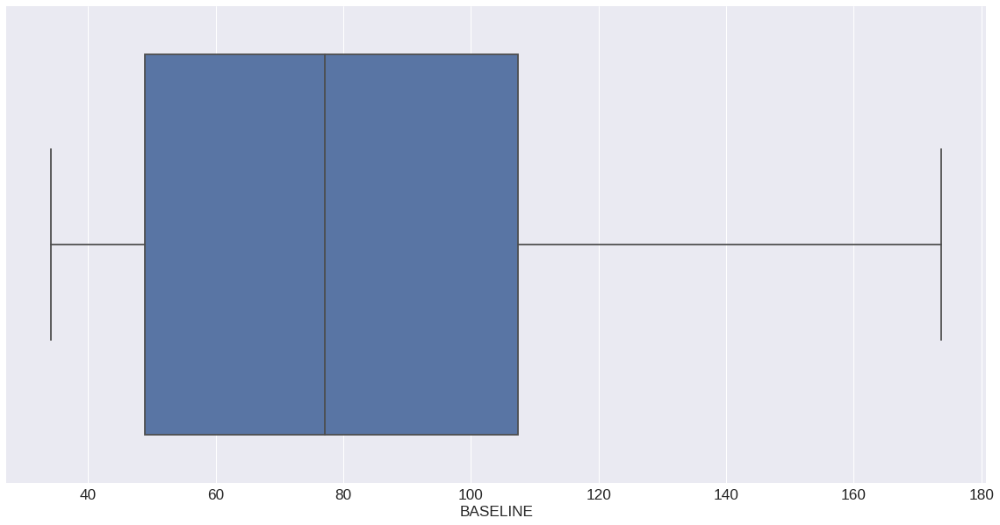

In [ ]:
for i in ['LINEAR REGRESSION','SVR MODEL','FNN REGRESSION MODEL','ARIMA MODEL','BASELINE']:
  #you could compare ranges here
  sns.boxplot(residuals[i])
  plt.show()

In [ ]:
residuals.describe()

,LINEAR REGRESSION,SVR MODEL,FNN REGRESSION MODEL,ARIMA MODEL,BASELINE
count,861.000000,861.000000,861.000000,861.000000,861.000000
mean,0.170123,9.508026,-0.118312,0.473704,83.073293
std,25.173360,25.397356,7.444828,5.841756,36.292673
min,-174.245513,-28.051520,-87.522354,-23.127557,34.151686
25%,-14.248311,-7.189171,-2.196978,-0.723240,48.875143
50%,-4.295559,-0.337930,-0.476586,0.102861,77.104025
75%,10.850170,16.618715,1.652817,1.465017,107.311254
max,127.724121,122.733181,52.728088,106.302257,173.775259


In [ ]:
def compare(rmse1,rmse2,rmse3,rmse4,rmse5):
  rmse=pd.DataFrame()
  rmse['Model']=['LINEAR REGRESSION','SVR MODEL','FNN REGRESSION MODEL','ARIMA MODEL','Baseline']
  rmse['RMSE']=[rmse1,rmse2,rmse3,rmse4,rmse5]
  l=np.min(rmse["RMSE"])
  for i in range(len(rmse)):
      if l==rmse.iloc[i]['RMSE']:
        best=rmse.iloc[i]["Model"]

  print("BEST MODEL:"+best+":"+str(l))
  return l,best

In [ ]:
l,best=compare(rmse1,rmse2,rmse3,rmse4,rmse5)

BEST MODEL:ARIMA MODEL:5.857547938356459


### RMSE Comparison

In [ ]:
# Here, we are comparing the rmse values of all the models. You can clearly see the results.  
rmse=pd.DataFrame()
rmse['Model']=['LINEAR REGRESSION','SVR MODEL','FFNN REGRESSION MODEL','ARIMA MODEL','Baseline']
rmse['RMSE']=[rmse1,rmse2,rmse3,rmse4,rmse5]
print(rmse)

                   Model       RMSE
0      LINEAR REGRESSION  25.173936
1              SVR MODEL  27.120718
2  FFNN REGRESSION MODEL   7.445769
3            ARIMA MODEL   5.857548
4               Baseline  90.646568


In [ ]:
def plotdiff(y_test,y_pred1,model):
  plt.plot(test_preds,y1_test,'bo',)
  plt.xlabel('Actual Test Ladder Score')
  plt.ylabel('Predicted Test Ladder Score')
  plt.title(model)
  plt.plot(range(250),range(250),'--g',) #line where actual = predicted
  plt.tight_layout()
  plt.show()

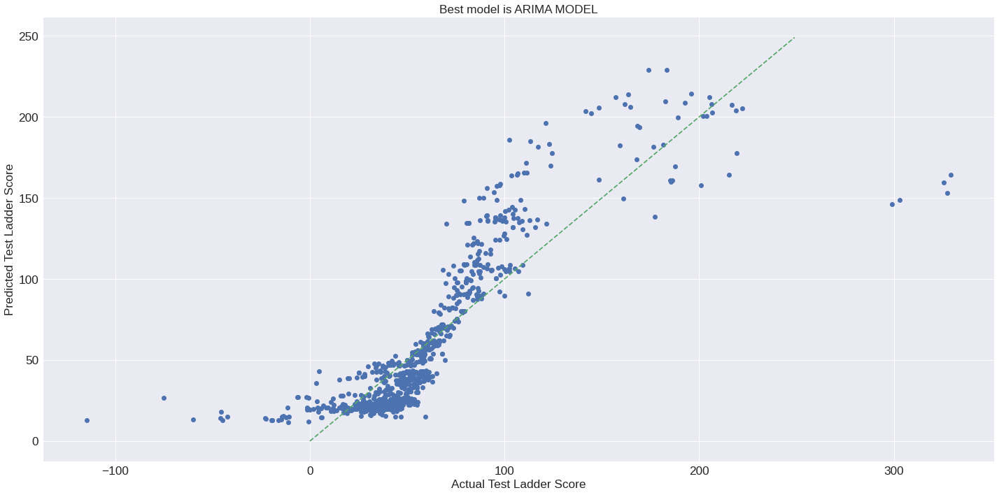

In [ ]:
  model="Best model is "+best
  if l==rmse1:
    plotdiff(y_test,y_pred1,model)
  elif l==rmse2:
    plotdiff(y_test,y_pred2,model)
  elif l==rmse3:
    plotdiff(y_test,y_pred3,model)
  elif l==rmse4:
    plotdiff(test_data,pred,model)
  elif l==rmse5:
    plotdiff(y1_test,pred1,model)
  elif l==rmse6:
    plotdiff(y1_test,pred2,model)
  elif l==rmse7:
    plotdiff(y1_test,pred3,model)
  elif l==rmse8:
    plotdiff(y1_test,pred4,model)
  elif l==rmse9:
    plotdiff(y1_test,pred5,model)
  else:
    print("Error")
  

#CONCLUSION

1. Among the four models- Linear Regression, SVR model, FFNN Regression Model and ARIMA Model - when compared with Baseline Model. The best fit model we get is in seasonal ARIMA timeseries model.  
2. From the residual analysis, best fit is ARIMA model with residuals mean 0.34 and then FFNN regression model with residuals mean 0.089.
3. From the RMSE  values, we observed that we were able to predict the stock prices of Microsoft with an error of 5.5 in Adjusted close price of share. 
